In [1]:
import pandas as pd
import csv
import numpy as np
import matplotlib.pyplot as plt
import time
import os
import sys
import subprocess
import seaborn as sns
from copy import deepcopy
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.patches as mpatches
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.lines import Line2D
import geopandas as gpd
from sklearn.metrics.pairwise import haversine_distances
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.gridspec as gridspec
import matplotlib as mpl
import rasterio as rio
from rasterio.plot import show

In [2]:
# Load random forest results grids
grid_5 = gpd.read_file('/Users/vivianhuang/Desktop/reproject_grid/grid_005d_process4.shp')
print(grid_5.crs)
#grid_5 = grid_5.set_crs('None', allow_override=True)
print(grid_5.crs)

EPSG:4326
EPSG:4326


In [7]:
this_fontsize=30

In [35]:
def plot_10_cv_maps(csv_saving_dir,csv_saving_prefix,bug_name):
    fig, ax = plt.subplots(3,4, figsize=(60,25))
    for i in range(10):   
        ax_0 = i // 4
        ax_1 = i % 4       
        world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
        world.boundary.plot(ax=ax[ax_0,ax_1], color = 'slategrey',linewidth=1,figsize=(6,5))

        this_csv_path = csv_saving_dir +csv_saving_prefix+'_'+str(i+1)+"_"+bug_name+'.csv'

        this_prediction = pd.read_csv(this_csv_path)
        this_prediction.drop(columns=['Unnamed: 0'], inplace=True)
        gdf_merge = gpd.GeoDataFrame(this_prediction.merge(grid_5, on="id"))
        gdf_merge.plot(column='prediction', ax=ax[ax_0,ax_1], cmap="viridis",vmin=0, vmax=1)
        ax[ax_0,ax_1].set_aspect('equal')
        ax[ax_0,ax_1].set_xlim([-180,-52])
        ax[ax_0,ax_1].set_ylim([13,85])
        ax[ax_0,ax_1].tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
        ax[ax_0,ax_1].set_title(str(i+1), size=this_fontsize)

    plt.subplots_adjust(hspace=0.2)
    plt.subplots_adjust(wspace=0.2)
    plt.gcf().text(0.45, 0.92, bug_name+' '+csv_saving_prefix, fontsize=this_fontsize*1.5)
    ax[2][2].axis('off')
    ax[2][3].axis('off')

    ax2 =fig.add_axes([0.62,0.16,0.20,0.015])
    cb = mpl.colorbar.ColorbarBase(ax2, orientation='horizontal', cmap='viridis')
    cb.set_label("$p$", labelpad=-20, size=this_fontsize)
    cb.ax.tick_params(labelsize=this_fontsize)
    #'T. dimidiata','T. gerstaeckeri','T. protracta','T. sanguisuga'
    plt.savefig(csv_saving_dir+csv_saving_prefix+'_'+bug_name+".png",dpi=100)

# PCA Grid plot

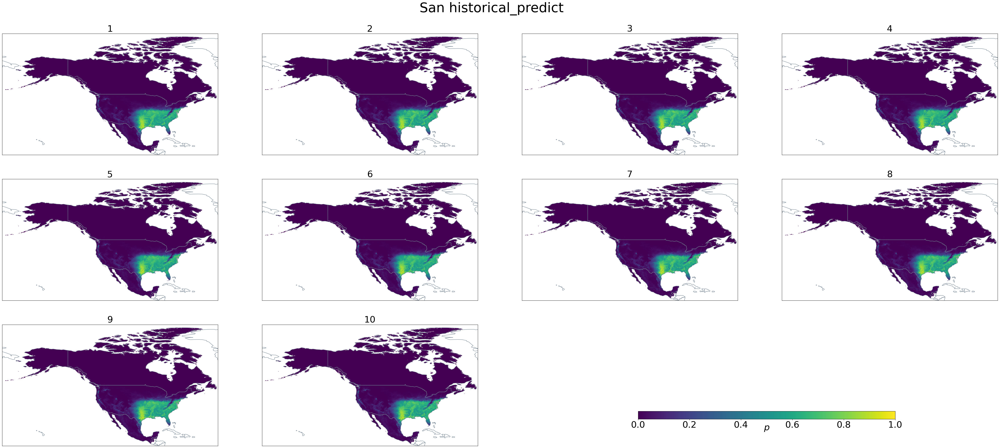

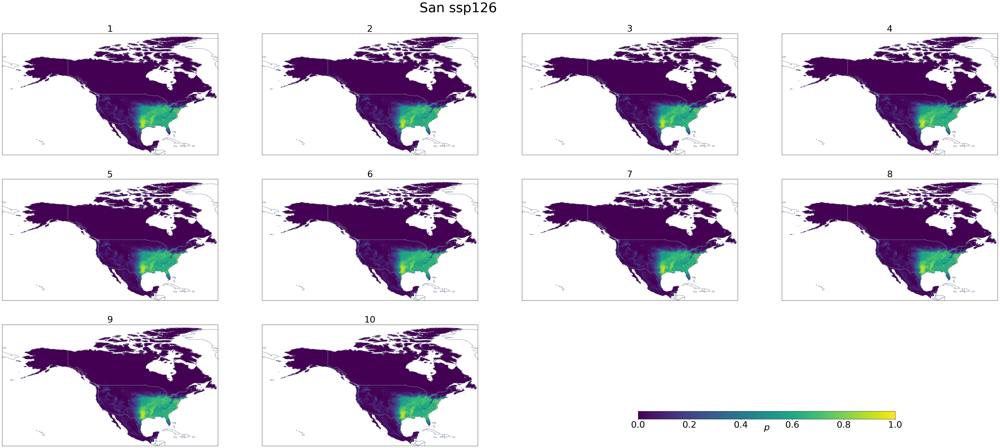

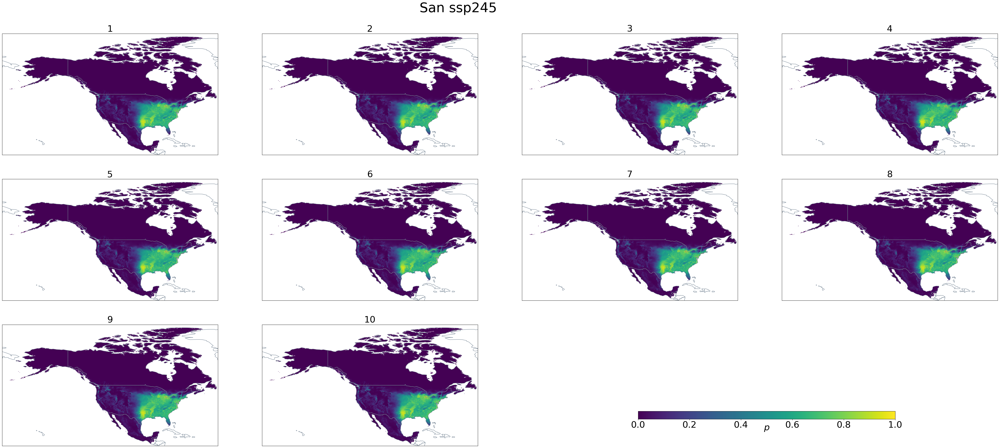

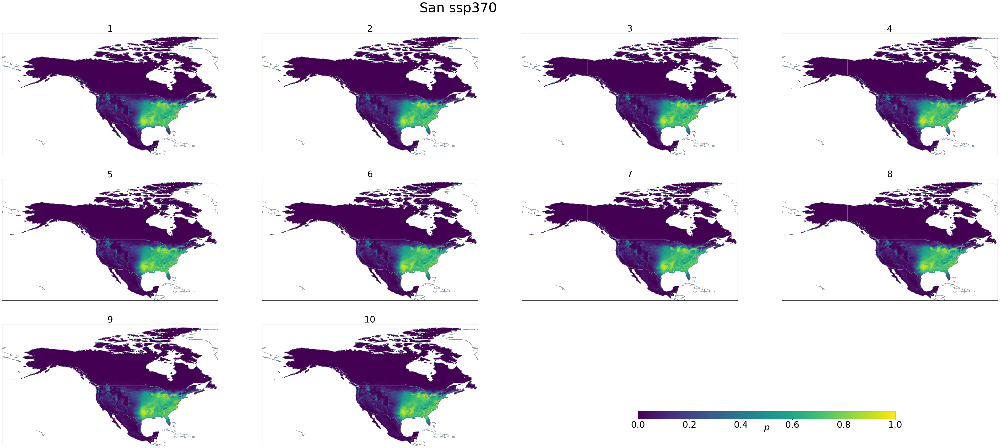

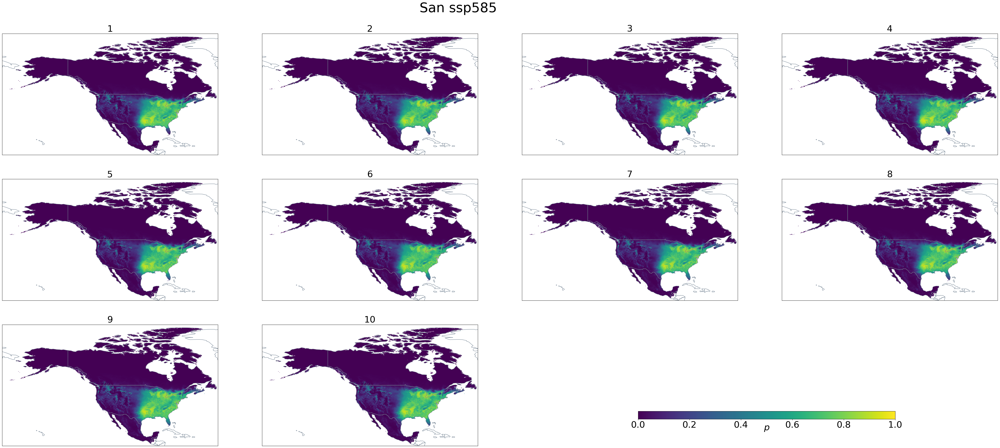

In [37]:
plot_10_cv_maps(csv_saving_dir="/Users/vivianhuang/Desktop/R-modeling-scripts/r_chagasM/output/kfold_grid_process/San/result/output_raster/cross_validation/", 
                csv_saving_prefix="historical_predict",
                bug_name="San")
plot_10_cv_maps(csv_saving_dir="/Users/vivianhuang/Desktop/R-modeling-scripts/r_chagasM/output/kfold_grid_process/San/result/output_raster/cross_validation/", 
                csv_saving_prefix="ssp126",
                bug_name="San")
plot_10_cv_maps(csv_saving_dir="/Users/vivianhuang/Desktop/R-modeling-scripts/r_chagasM/output/kfold_grid_process/San/result/output_raster/cross_validation/", 
                csv_saving_prefix="ssp245",
                bug_name="San")
plot_10_cv_maps(csv_saving_dir="/Users/vivianhuang/Desktop/R-modeling-scripts/r_chagasM/output/kfold_grid_process/San/result/output_raster/cross_validation/", 
                csv_saving_prefix="ssp370",
                bug_name="San")
plot_10_cv_maps(csv_saving_dir="/Users/vivianhuang/Desktop/R-modeling-scripts/r_chagasM/output/kfold_grid_process/San/result/output_raster/cross_validation/", 
                csv_saving_prefix="ssp585",
                bug_name="San")

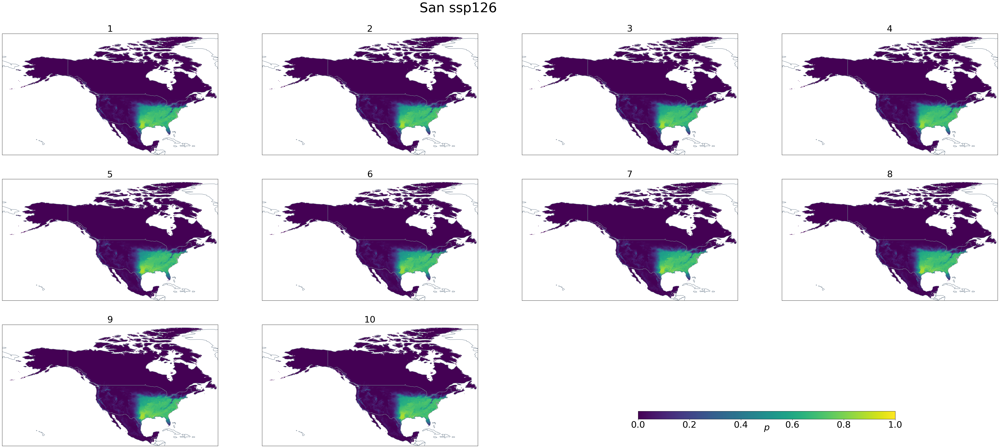

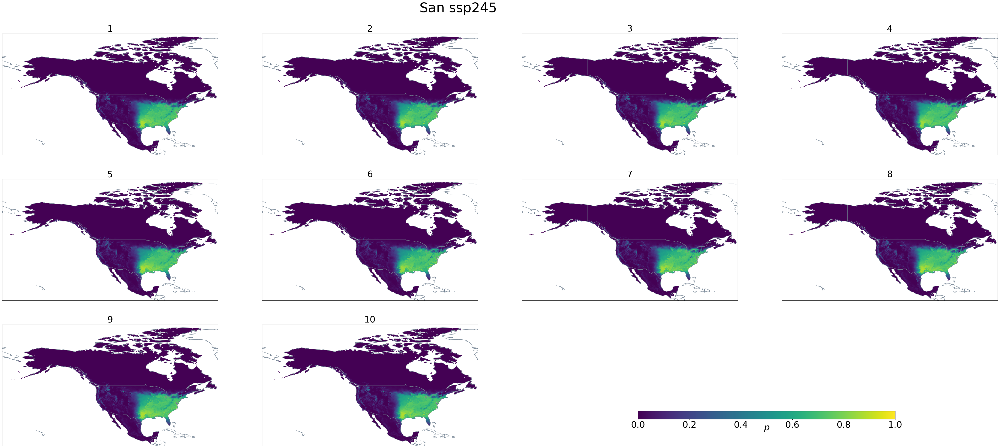

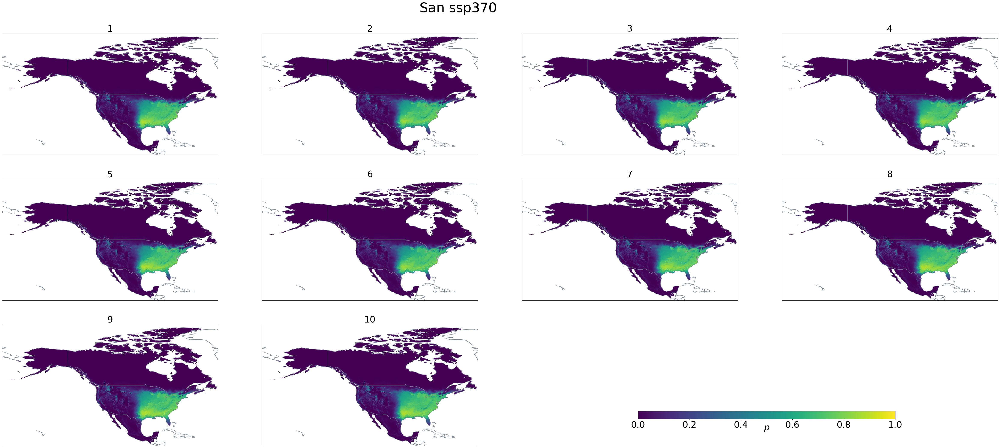

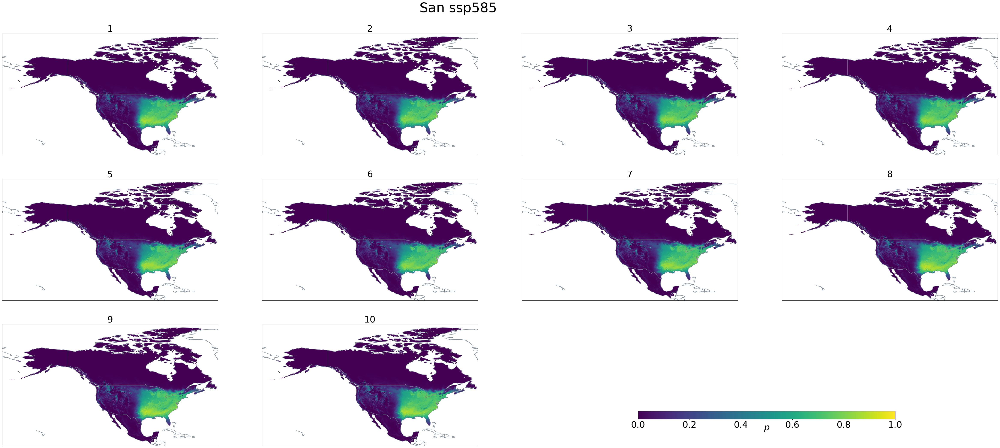

In [36]:
plot_10_cv_maps(csv_saving_dir="/Users/vivianhuang/Desktop/R-modeling-scripts/r_chagasM/output/kfold_grid_buffer_process/San/result/output_raster/cross_validation/", 
                csv_saving_prefix="ssp126",
                bug_name="San")
plot_10_cv_maps(csv_saving_dir="/Users/vivianhuang/Desktop/R-modeling-scripts/r_chagasM/output/kfold_grid_buffer_process/San/result/output_raster/cross_validation/", 
                csv_saving_prefix="ssp245",
                bug_name="San")
plot_10_cv_maps(csv_saving_dir="/Users/vivianhuang/Desktop/R-modeling-scripts/r_chagasM/output/kfold_grid_buffer_process/San/result/output_raster/cross_validation/", 
                csv_saving_prefix="ssp370",
                bug_name="San")
plot_10_cv_maps(csv_saving_dir="/Users/vivianhuang/Desktop/R-modeling-scripts/r_chagasM/output/kfold_grid_buffer_process/San/result/output_raster/cross_validation/", 
                csv_saving_prefix="ssp585",
                bug_name="San")